In [ ]:
!apt install -y tesseract-ocr  # Install Tesseract OCR
!pip install pymupdf pytesseract opencv-python pillow numpy  # Install required Python libraries

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
tesseract-ocr is already the newest version (4.1.1-2.1build1).
0 upgraded, 0 newly installed, 0 to remove and 35 not upgraded.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.1/24.1 MB 62.3 MB/s eta 0:00:00


In [ ]:
import cv2
import pytesseract
import fitz  # PyMuPDF
import numpy as np
from PIL import Image
import re

In [ ]:
doc = fitz.open('MTG_10009588.pdf')

In [ ]:
cd /content/drive/MyDrive/Extern_Outomation/

/content/drive/MyDrive/Extern_Outomation


In [ ]:
pip install pdf2image

In [ ]:
from pdf2image import convert_from_path

pages = convert_from_path('MTG_10009588.pdf', dpi=300)
img = pages[0]  # Use the first page for now


In [ ]:
!apt-get install poppler-utils -y

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following NEW packages will be installed:
  poppler-utils
0 upgraded, 1 newly installed, 0 to remove and 35 not upgraded.
Need to get 186 kB of archives.
After this operation, 697 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy-updates/main amd64 poppler-utils amd64 22.02.0-2ubuntu0.10 [186 kB]
Fetched 186 kB in 0s (546 kB/s)
Selecting previously unselected package poppler-utils.
(Reading database ... 126371 files and directories currently installed.)
Preparing to unpack .../poppler-utils_22.02.0-2ubuntu0.10_amd64.deb ...
Unpacking poppler-utils (22.02.0-2ubuntu0.10) ...
Setting up poppler-utils (22.02.0-2ubuntu0.10) ...
Processing triggers for man-db (2.10.2-1) ...


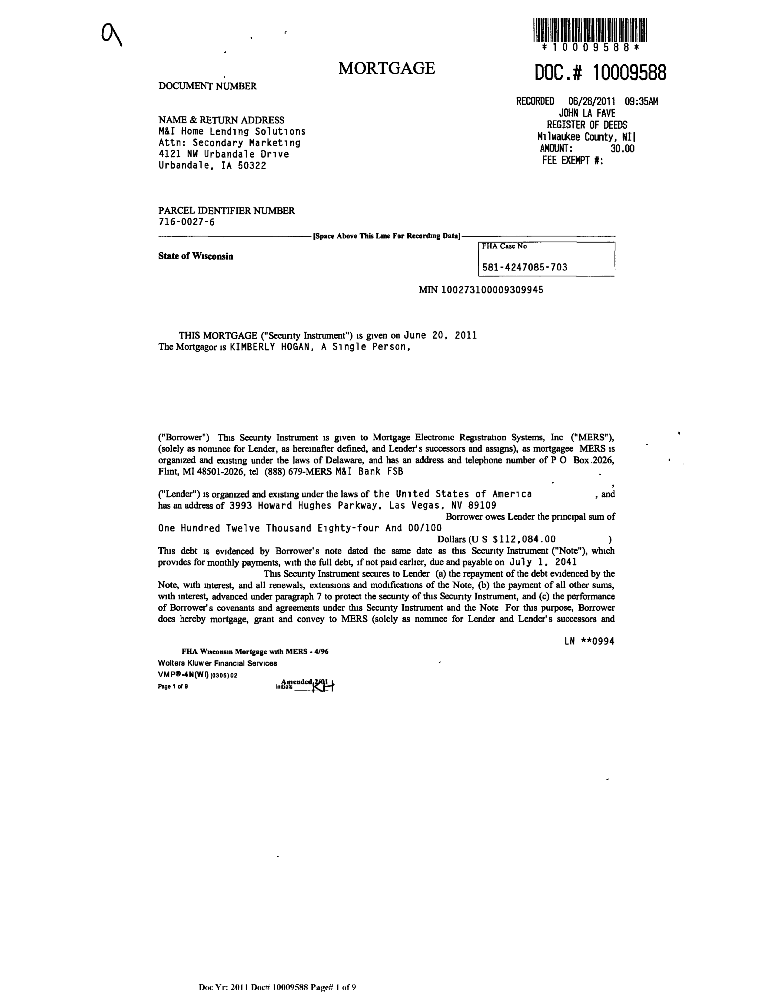

In [ ]:
img

#moving with pdf2image as its much better in extracting the image

In [ ]:
img_list = []

for img in pages:
  img_list.append(img)

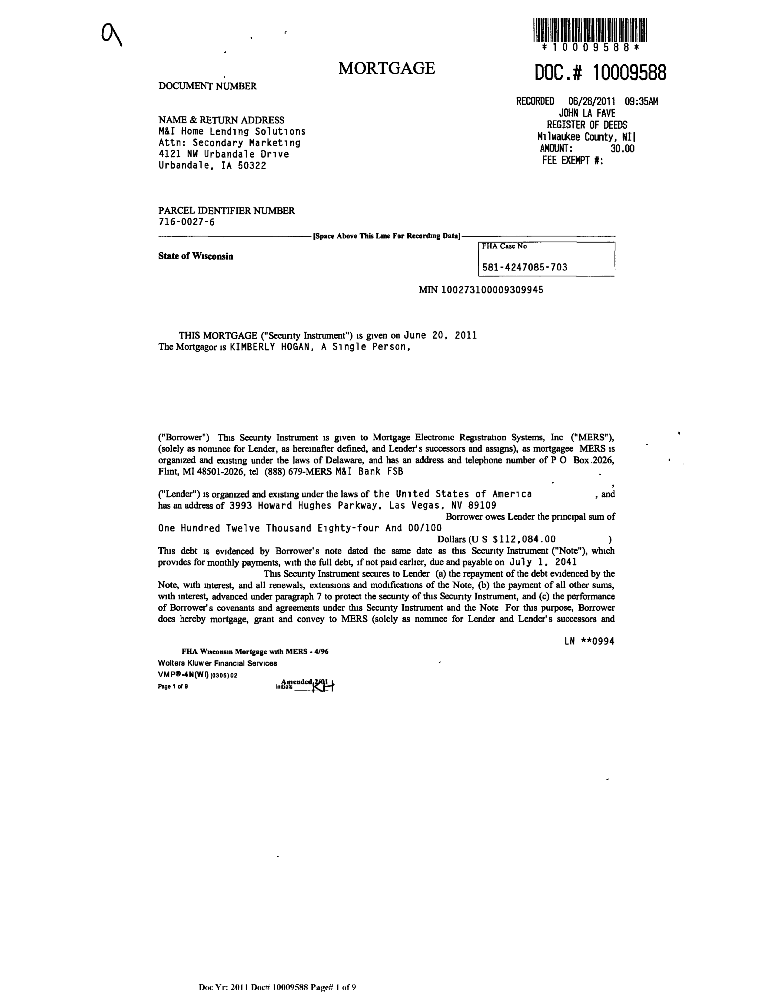

In [ ]:
img_list[0]

In [ ]:
def preprocess_img(image_list):
  new_list = []
  for img in image_list:
    img_cv = cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR)
    gray = cv2.cvtColor(img_cv, cv2.COLOR_BGR2GRAY)
    gray = cv2.medianBlur(gray, 3)
    gray = cv2.createCLAHE(clipLimit = 2.0, tileGridSize = (3,3)).apply(gray)
    gray = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)
    new_list.append(gray)
  return new_list

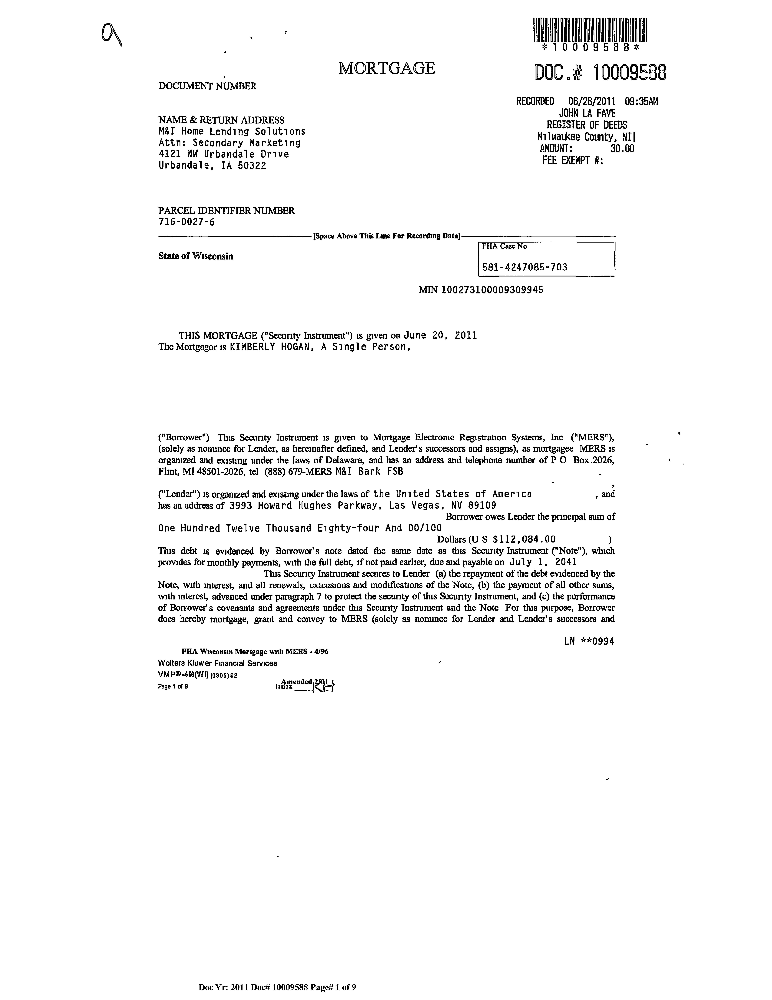

In [ ]:
Image.fromarray(preprocess_img(img_list)[0]) #checking one processed page

In [ ]:
cleaned_images = preprocess_img(img_list)

In [ ]:
#sample

print(pytesseract.image_to_string(cleaned_images[0]))

oo cc

*100095

MORTGAGE DOC .# 10009586

DOCUMENT NUMBER

RECORDED 06/28/2011 09:35AM
JOHN LA FAVE
NAME & RETURN ADDRESS REGISTER OF DEEDS
M&I Home Lending Solutions Milwaukee County, WI|
Attn: Secondary Marketing AMOUNT: 30 00

4121 NW Urbandale Drive

Urbandale, IA 50322 FEE EXEMPT #:

PARCEL IDENTIFIER NUMBER
716-0027-6

[Space Above This Line For Recording Data]

FHA Case No
State of Wisconsin
§81-4247085-703

MIN 100273100009309945

THIS MORTGAGE ("Security Instrument") 1s given on June 20, 2011
The Mortgagor is KIMBERLY HOGAN, A Single Person,

("Borrower") This Security Instrument 1s given to Mortgage Electronic Registration Systems, Inc ("MERS"),
(solely as nominee for Lender, as hereinafter defined, and Lender's successors and assigns), as mortgagee MERS 1s
organized and existing under the laws of Delaware, and has an address and telephone number of P O Box .2026,
Flint, MI 48501-2026, tel (888) 679-MERS M&I Bank FSB .
("Lender") 1s organized and existing under the laws of th

In [ ]:
def clean_text(text):
    # Remove unwanted characters, fix common OCR errors, etc.
    text = re.sub(r'[^a-zA-Z0-9\s,.%-]', '', text)
    text = re.sub(r'\bL0AN\b', 'LOAN', text, flags=re.IGNORECASE)
    text = re.sub(r'\bM0RTGAGE\b', 'MORTGAGE', text, flags=re.IGNORECASE)
    text = re.sub(r'\b1NTEREST\b', 'INTEREST', text, flags=re.IGNORECASE)
    return text.strip()

In [ ]:
word_dicts = []

for i in range(len(cleaned_images)):
  word_dicts.append(pytesseract.image_to_data(cleaned_images[i], output_type = pytesseract.Output.DICT))
  word_dicts[i]['text'] = [clean_text(text) for text in word_dicts[i]['text']]

In [ ]:
#sample text, bbox, and confidence check

for i in range(10):
  print(f'Words: {word_dicts[0]['text'][i]}, Bbox: {word_dicts[0]['left'][i],word_dicts[0]['top'][i], word_dicts[0]['width'][i], word_dicts[0]['height'][i]}, Confidence: {word_dicts[0]["conf"][i]}')

Words: , Bbox: (0, 0, 5100, 6601), Confidence: -1
Words: , Bbox: (1655, 117, 2619, 221), Confidence: -1
Words: , Bbox: (1655, 117, 2619, 221), Confidence: -1
Words: , Bbox: (1655, 117, 2619, 221), Confidence: -1
Words: oo, Bbox: (1743, 96, 111, 221), Confidence: 0
Words: cc, Bbox: (3703, 117, 224, 162), Confidence: 12
Words: , Bbox: (3582, 281, 437, 57), Confidence: -1
Words: , Bbox: (3582, 281, 437, 57), Confidence: -1
Words: , Bbox: (3582, 281, 437, 57), Confidence: -1
Words: 100095, Bbox: (3582, 281, 437, 57), Confidence: 87


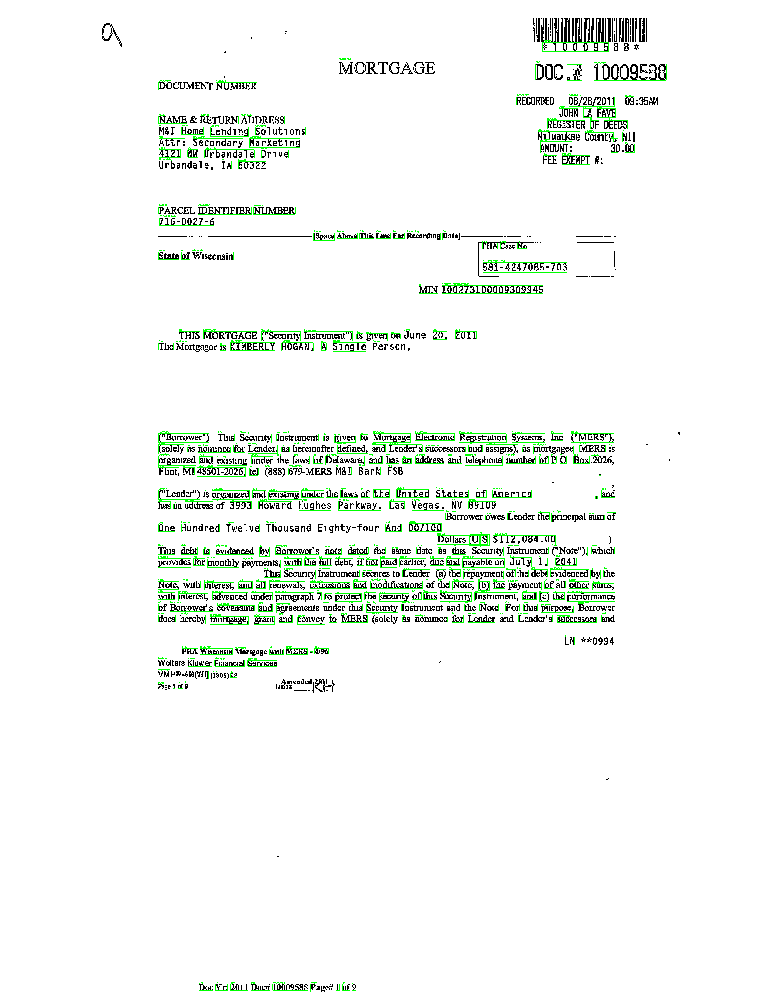

In [ ]:
img_bgr = cv2.cvtColor(cleaned_images[0], cv2.COLOR_RGB2BGR)

# Get OpenCV image height for correct y-coordinate transformation
page_height = cleaned_images[0].shape[0]

# Define confidence threshold (ignore low-confidence words)
confidence_threshold = 40

# Loop through Extracted OCR Words & Draw Bounding Boxes
for i in range(len(word_dicts[0]["text"])):
    word = word_dicts[0]["text"][i].strip()
    x, y, w, h = word_dicts[0]["left"][i], word_dicts[0]["top"][i], word_dicts[0]["width"][i], word_dicts[0]["height"][i]
    conf = int(word_dicts[0]["conf"][i])  # Convert confidence to int

    # Ignore empty words & low-confidence OCR text
    if not word or conf < confidence_threshold:
        continue

    # Draw bounding box
    cv2.rectangle(img_bgr, (x, y), (x + w, y + h), (0, 255, 0), 2)
    cv2.putText(img_bgr, word, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

# Convert Back to RGB & Display the Image
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
display(Image.fromarray(img_rgb))

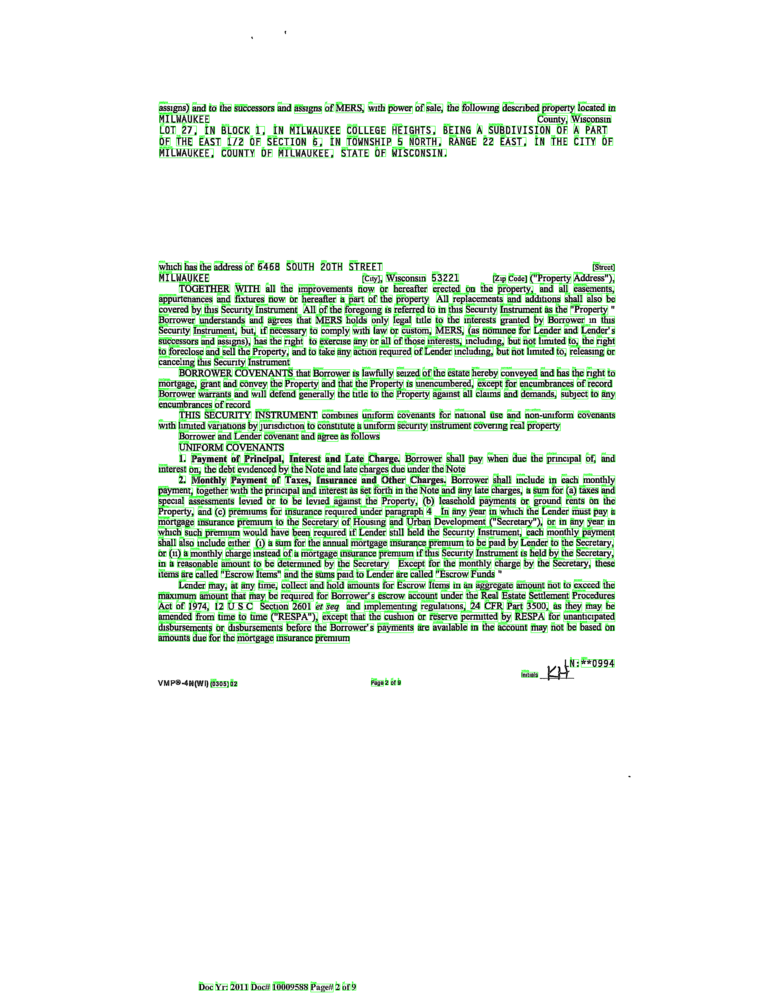

In [ ]:
img_bgr = cv2.cvtColor(cleaned_images[1], cv2.COLOR_RGB2BGR)

# Get OpenCV image height for correct y-coordinate transformation
page_height = cleaned_images[1].shape[0]

# Define confidence threshold (ignore low-confidence words)
confidence_threshold = 40

# Loop through Extracted OCR Words & Draw Bounding Boxes
for i in range(len(word_dicts[1]["text"])):
    word = word_dicts[1]["text"][i].strip()
    x, y, w, h = word_dicts[1]["left"][i], word_dicts[1]["top"][i], word_dicts[1]["width"][i], word_dicts[1]["height"][i]
    conf = int(word_dicts[1]["conf"][i])  # Convert confidence to int

    # Ignore empty words & low-confidence OCR text
    if not word or conf < confidence_threshold:
        continue

    # Draw bounding box
    cv2.rectangle(img_bgr, (x, y), (x + w, y + h), (0, 255, 0), 2)
    cv2.putText(img_bgr, word, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

# Convert Back to RGB & Display the Image
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
display(Image.fromarray(img_rgb))

In [ ]:
len(word_dicts)

4

In [ ]:
key_fields = [
    "MORTGAGE", "NOTE", "LENDER", "PROPERTY ADDRESS",
    "DATE", "SIGNATURE", "INTEREST RATE", "LOAN DATE",
    "RECORDING DATE", "DEED OF TRUST", "LOCATION",
    "SIGNING", "CHARGES", "INTEREST", "INTEREST RATE",
    'ADDRESS'
    ]

extracted_data = []

for word_dict in word_dicts:
  temp_dict = dict()
  for i in range(len(word_dict['text'])):
    x, y, w, h = word_dict["left"][i], word_dict["top"][i], word_dict["width"][i], word_dict["height"][i]
    for key in key_fields:
      if key.lower() in word_dict['text'][i].lower():
        temp_dict[word_dict['text'][i]] = {
            "text": word_dict['text'][i],
            "bounding_box": [x, y, w, h],
            'conf': int(word_dict["conf"][i])
        }
  extracted_data.append(temp_dict)

In [ ]:
import json

json_output = json.dumps(extracted_data, indent=4)

# Print structured JSON output
print(json_output)

[
    {
        "MORTGAGE": {
            "text": "MORTGAGE",
            "bounding_box": [
                1343,
                2189,
                355,
                50
            ],
            "conf": 96
        },
        "ADDRESS": {
            "text": "ADDRESS",
            "bounding_box": [
                1592,
                767,
                286,
                51
            ],
            "conf": 96
        },
        "Mortgage": {
            "text": "Mortgage",
            "bounding_box": [
                1552,
                4284,
                212,
                46
            ],
            "conf": 90
        },
        "Lender,": {
            "text": "Lender,",
            "bounding_box": [
                1639,
                2937,
                195,
                57
            ],
            "conf": 96
        },
        "Lenders": {
            "text": "Lenders",
            "bounding_box": [
                3424,
                4059,
   

In [ ]:
def bounding_image(cleaned_images, word_dicts):

  image_list = []

  for i in range(len(cleaned_images)):

    img_bgr = cv2.cvtColor(cleaned_images[i], cv2.COLOR_RGB2BGR)

    for j in range(len(word_dicts[i]["text"])):
        word = word_dicts[i]['text'][j].strip().lower()
        x, y, w, h = word_dicts[i]["left"][j], word_dicts[i]["top"][j], word_dicts[i]["width"][j], word_dicts[i]["height"][j]

        for key in key_fields:
          if key.lower() in word:  # Highlight only key fields found in the document
            cv2.rectangle(img_bgr, (x, y), (x + w, y + h), (0, 0, 255), 2)  # Red bounding box
            cv2.putText(img_bgr, word, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)

    image_list.append(cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB))

  return image_list


In [ ]:
boxed_images = bounding_image(cleaned_images, word_dicts)

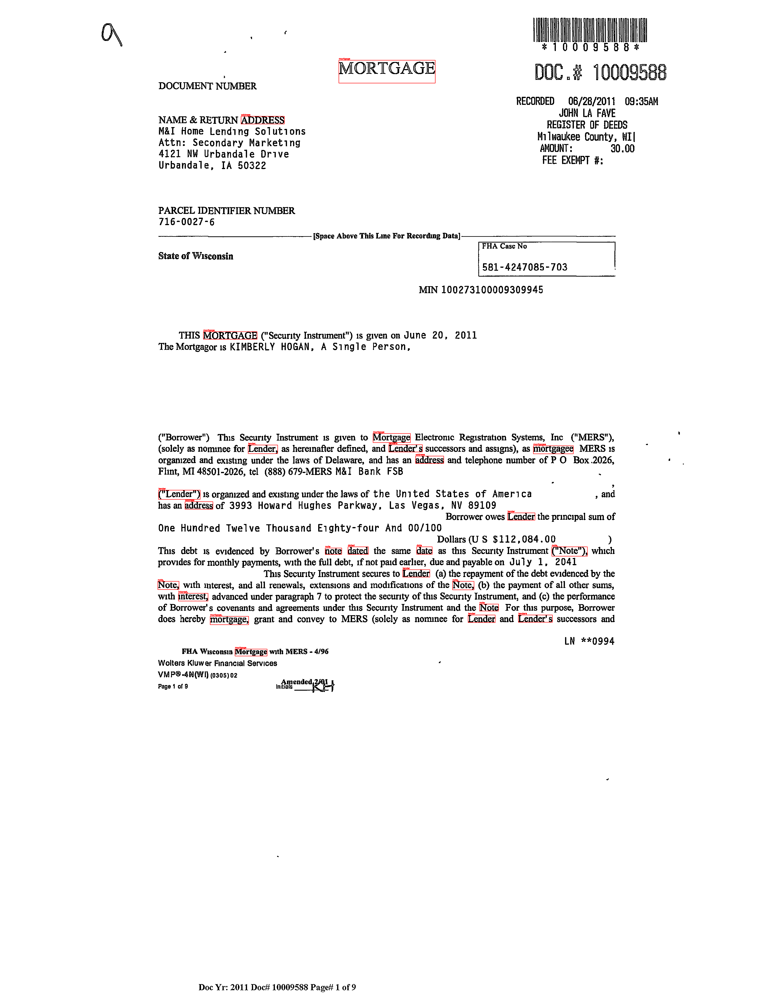

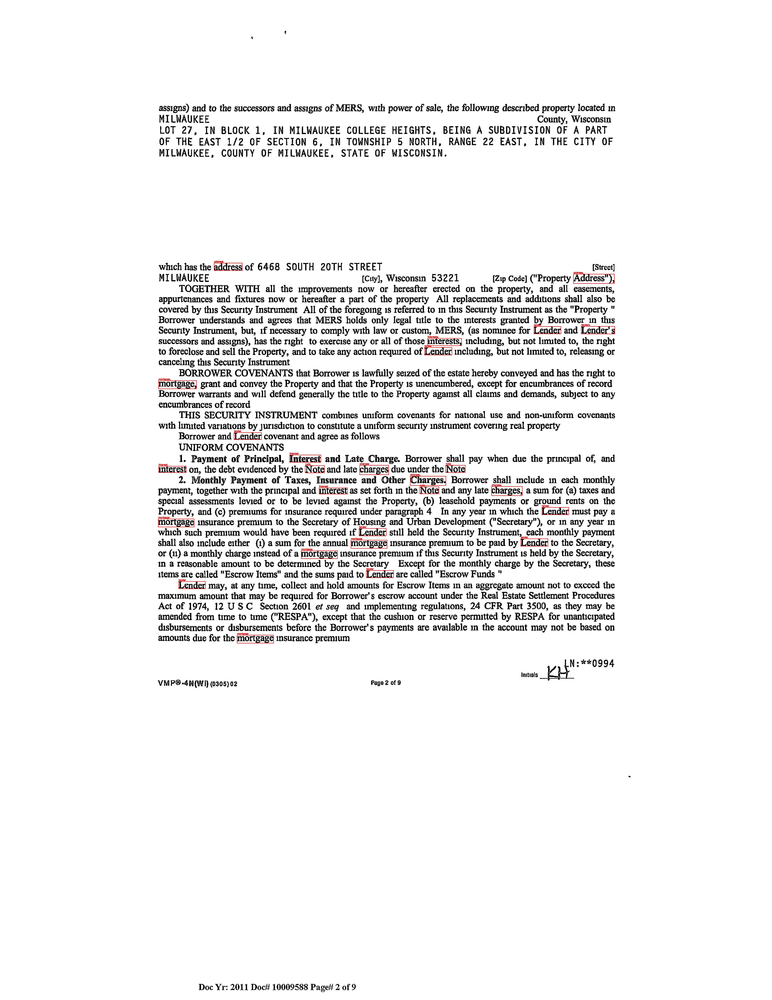

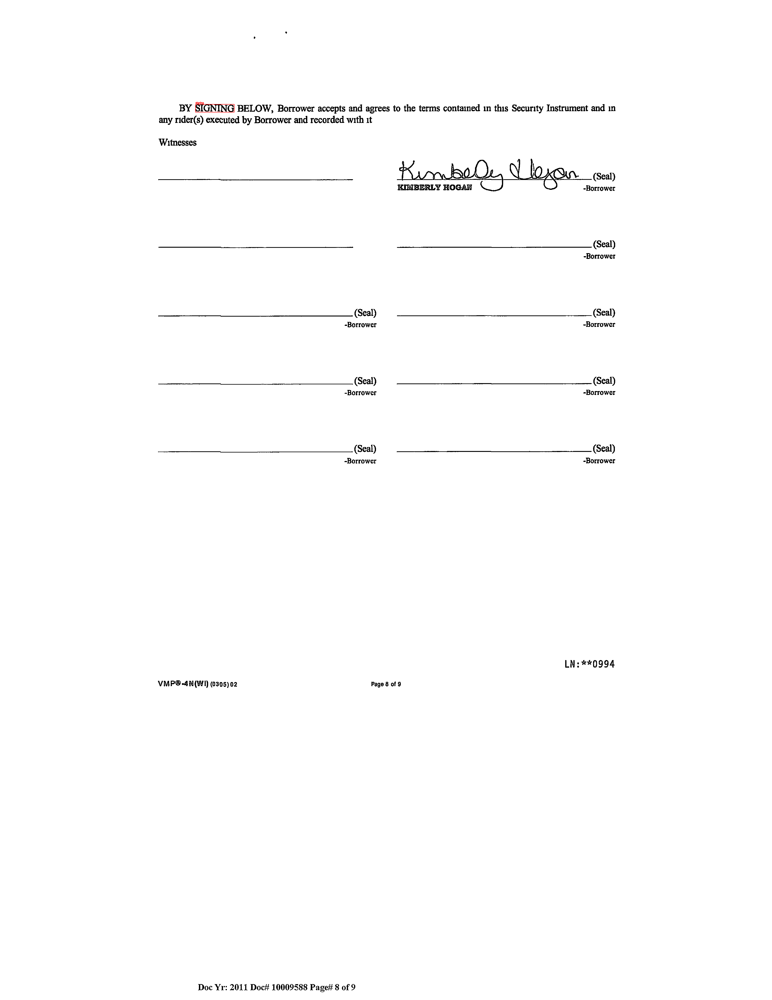

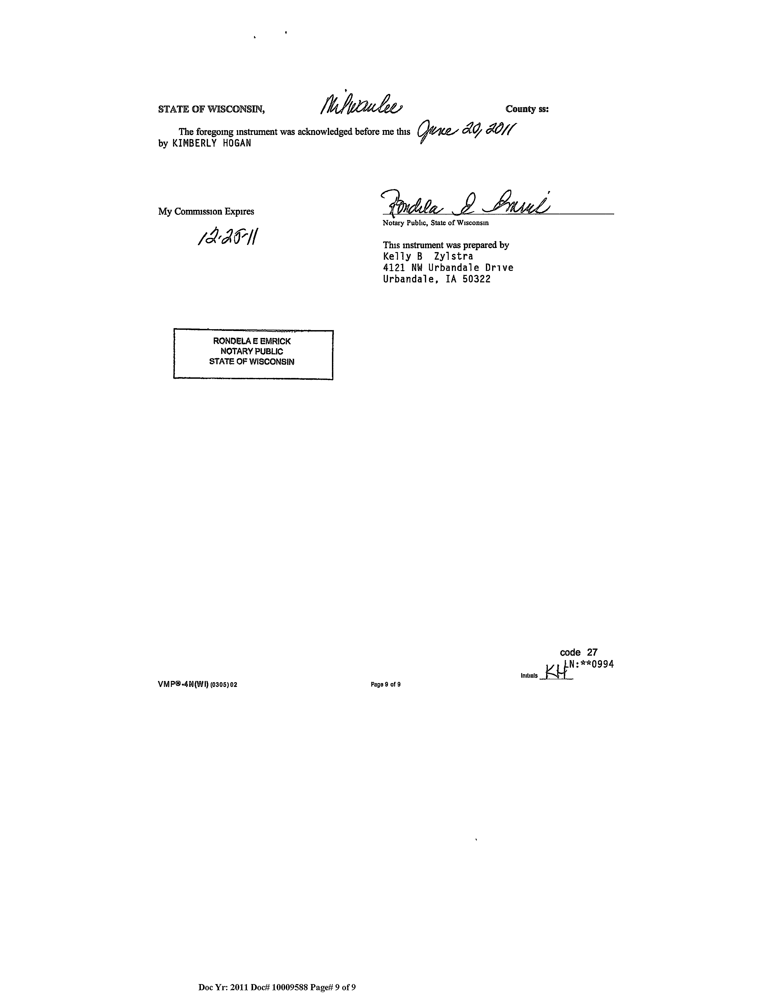

In [ ]:
for image in boxed_images:
  display(Image.fromarray(image))
  print('\n')